In [1]:
!pip install gdown

# Data Preprocessing

In [2]:
import gdown

# Specify the Google Drive URL
url = "https://drive.google.com/uc?id=1A2IU8Sgea1h3fYLpYtFb2v7NYdMjvEhU"
output = "mycheckpointfile"  # Specify the output filename0
gdown.download(url, output)

Downloading...
From (original): https://drive.google.com/uc?id=1A2IU8Sgea1h3fYLpYtFb2v7NYdMjvEhU
From (redirected): https://drive.google.com/uc?id=1A2IU8Sgea1h3fYLpYtFb2v7NYdMjvEhU&confirm=t&uuid=064851c0-b382-4e89-b9ed-5c4178304a3d
To: /kaggle/working/mycheckpointfile
100%|██████████| 7.61G/7.61G [01:06<00:00, 115MB/s] 


'mycheckpointfile'

In [3]:
!ls

mycheckpointfile


In [4]:
import tarfile
import os

# Specify the path to the downloaded tar file
tar_file_path = "mycheckpointfile"

# Specify the extraction directory
extract_dir = "extracted_data"
os.makedirs(extract_dir, exist_ok=True)

# Extract the contents of the tar file
with tarfile.open(tar_file_path, 'r') as tar_ref:
    tar_ref.extractall(extract_dir)

# Check the extracted files
extracted_files = os.listdir(extract_dir)
print("Extracted files:", extracted_files)

Extracted files: ['Task01_BrainTumour']


In [5]:
import nibabel as nib
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

import os
nii_img = nib.load('/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_484.nii.gz')
img_shape = nii_img.get_fdata().shape

print("Shape of NIfTI image:", img_shape)

Shape of NIfTI image: (240, 240, 155)


In [6]:
image_dir = "/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr"

# List all files in the directory
files = os.listdir(image_dir)

# Count the number of files
total_images = len(files)

print("Total number of images:", total_images)


Total number of images: 495


In [7]:
import os

# Directory path
image_dir = "/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/"

# List all files in the directory
files = os.listdir(image_dir)

# Extract numbers from filenames and convert them to integers
existing_numbers = []
for filename in files:
    parts = filename.split('_')
    if len(parts) == 2 and parts[0] == 'BRATS' and parts[1].split('.')[0].isdigit():
        existing_numbers.append(int(parts[1].split('.')[0]))

# Expected range of numbers
expected_numbers = range(1, 496)

# Find missing numbers
missing_numbers = [num for num in expected_numbers if num not in existing_numbers]

# Print missing images
if missing_numbers:
    print("Missing images:")
    for num in missing_numbers:
        print(f"BRATS_{num:03d}.nii.gz")
else:
    print("No images are missing.")


Missing images:
BRATS_485.nii.gz
BRATS_486.nii.gz
BRATS_487.nii.gz
BRATS_488.nii.gz
BRATS_489.nii.gz
BRATS_490.nii.gz
BRATS_491.nii.gz
BRATS_492.nii.gz
BRATS_493.nii.gz
BRATS_494.nii.gz
BRATS_495.nii.gz


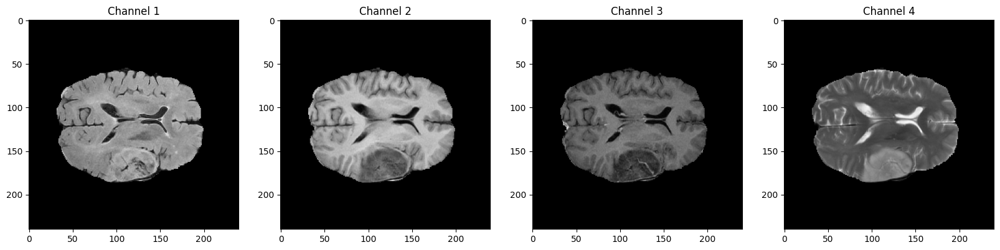

In [8]:
import nibabel as nib
import matplotlib.pyplot as plt

# Load the NIfTI image
nii_img = nib.load('/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/BRATS_243.nii.gz')
img_data = nii_img.get_fdata()

# Get the shape of the image data
img_shape = img_data.shape

# Define the number of channels
num_channels = img_shape[-1]

# Visualize each channel
fig, axes = plt.subplots(1, num_channels, figsize=(5*num_channels, 5))

for i in range(num_channels):
    # Show the i-th channel
    axes[i].imshow(img_data[:, :, 77, i], cmap='gray')
    axes[i].set_title(f'Channel {i+1}')

plt.show()

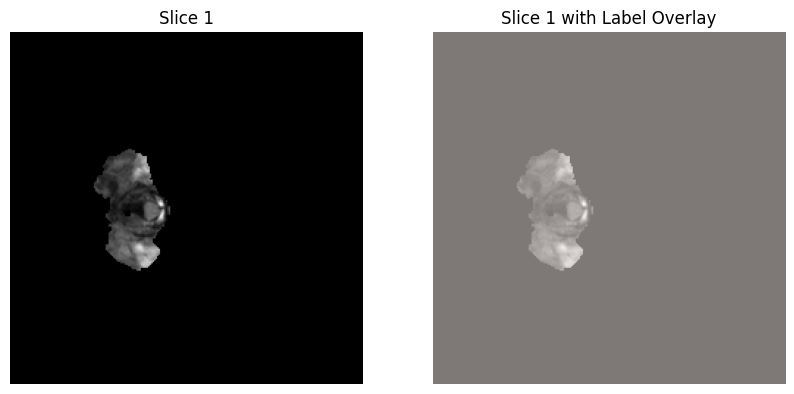

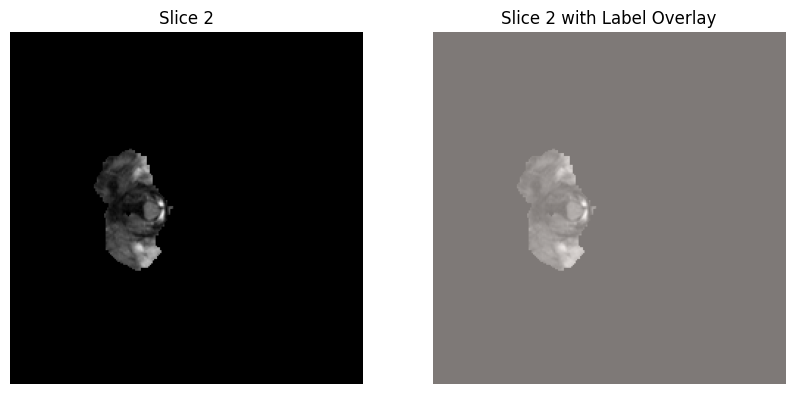

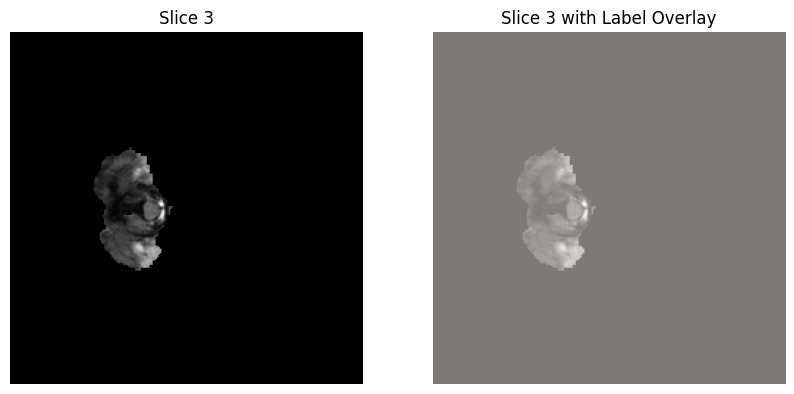

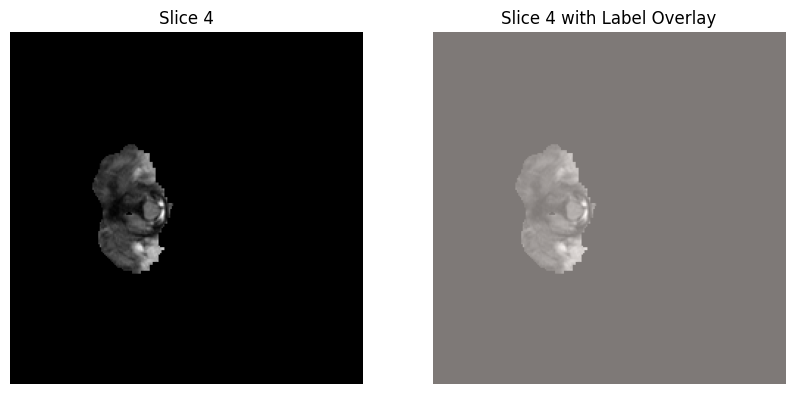

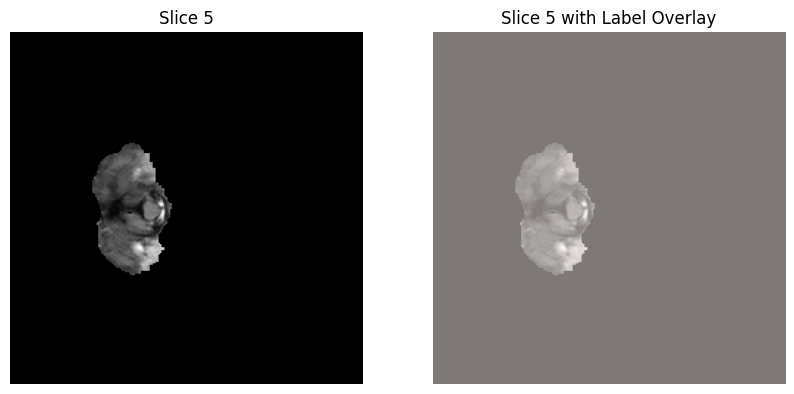

...

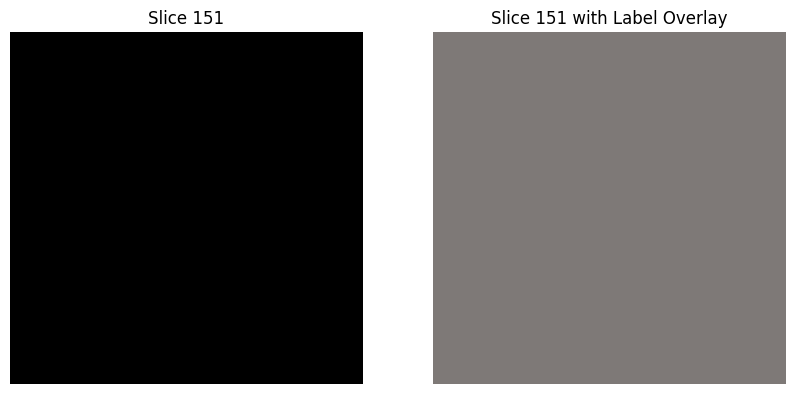

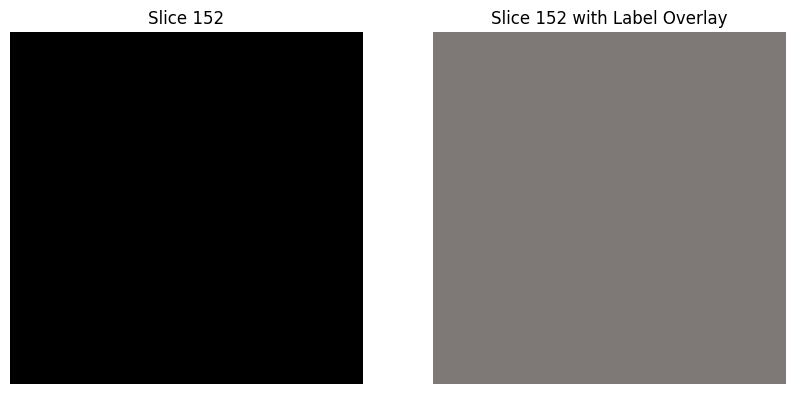

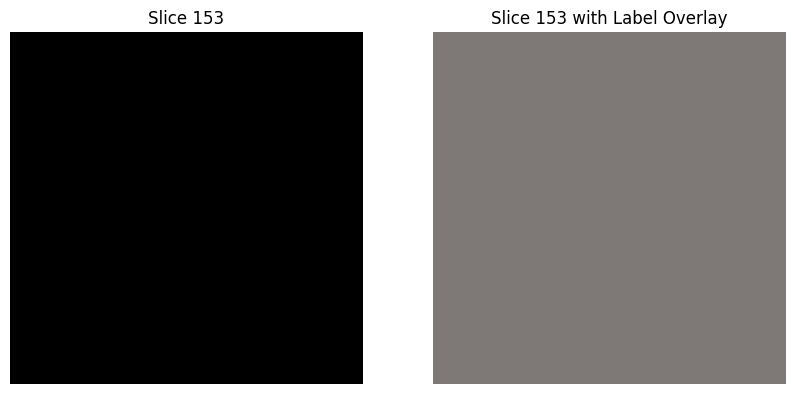

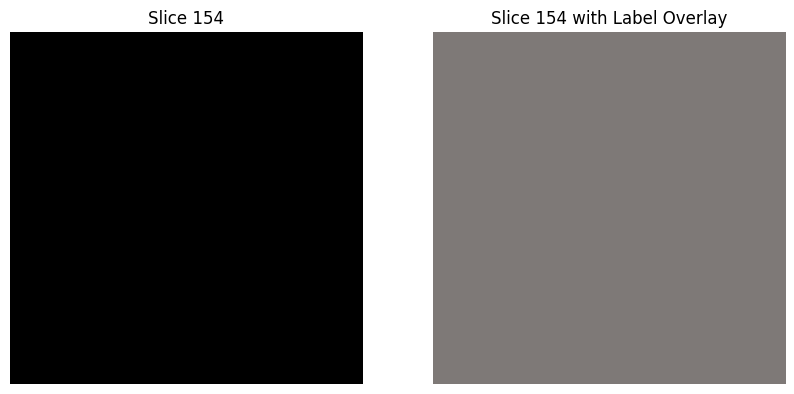

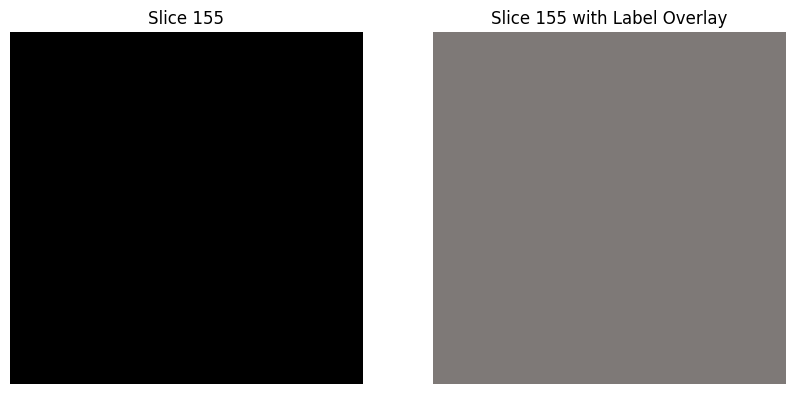

In [9]:
image_path = "/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/BRATS_120.nii.gz"
label_path = "/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_120.nii.gz"

# Load the image and label data
img = nib.load(image_path)
label_img = nib.load(label_path)

# Get the image and label data arrays
image_data = img.get_fdata()
label_data = label_img.get_fdata()

# Use only the first channel (assuming 0-indexing)
image_data_single_channel = image_data[..., 0]

# Plot each slice with label overlay
for slice_index in range(image_data.shape[2]):
    plt.figure(figsize=(10, 5))

    # Plot the original MRI image for the single channel and current slice
    plt.subplot(1, 2, 1)
    plt.imshow(image_data_single_channel[:, :, slice_index], cmap='gray')
    plt.title(f"Slice {slice_index+1}")
    plt.axis('off')

    # Plot the overlay of the label data in red
    plt.subplot(1, 2, 2)
    plt.imshow(image_data_single_channel[:, :, slice_index], cmap='gray')
    plt.imshow(label_data[:, :, slice_index], alpha=0.5, cmap='Reds')
    plt.title(f"Slice {slice_index+1} with Label Overlay")
    plt.axis('off')

    plt.show()


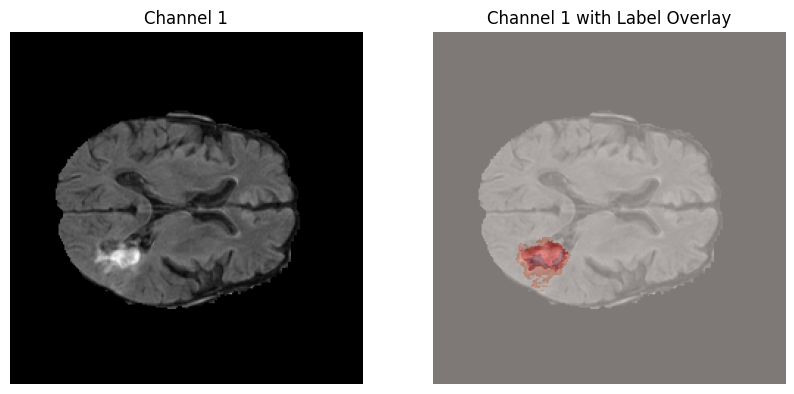

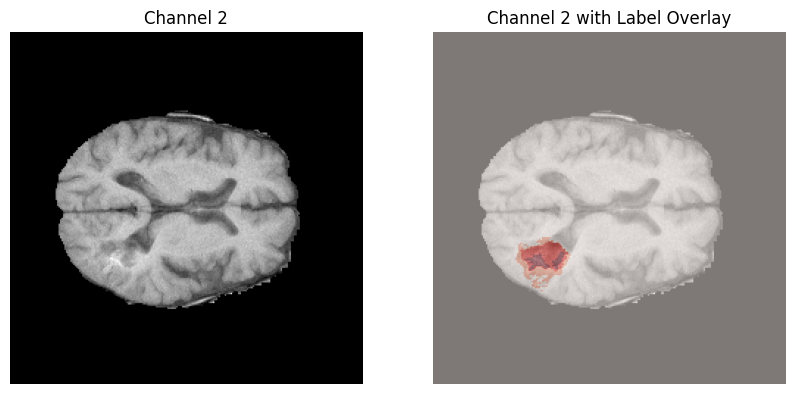

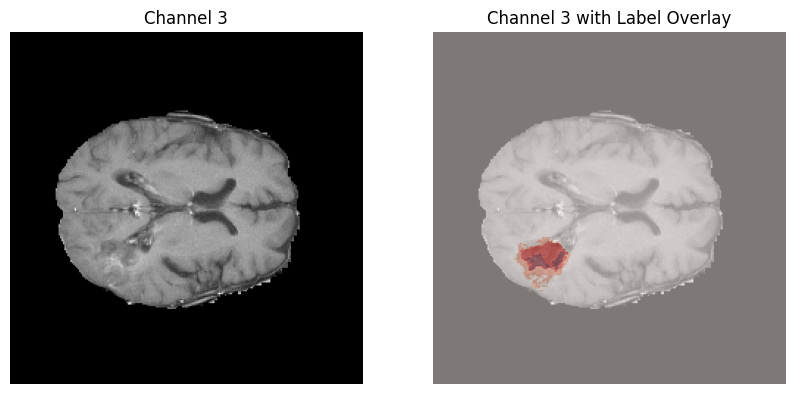

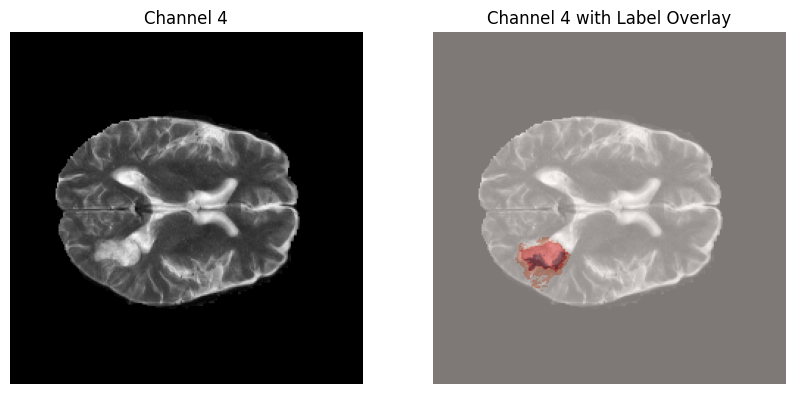

In [10]:
import nibabel as nib
import matplotlib.pyplot as plt

# Paths to image and label files
image_path = "/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/BRATS_120.nii.gz"
label_path = "/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_120.nii.gz"

# Load the image and label data
img = nib.load(image_path)
label_img = nib.load(label_path)

# Get the image and label data arrays
image_data = img.get_fdata()
label_data = label_img.get_fdata()

# Plot each channel with label overlay
for channel in range(image_data.shape[-1]):
    plt.figure(figsize=(10, 5))

    # Plot the original MRI image for the channel
    plt.subplot(1, 2, 1)
    plt.imshow(image_data[..., 77, channel], cmap='gray')  # Adjust the slice index as needed
    plt.title(f"Channel {channel+1}")
    plt.axis('off')

    # Plot the overlay of the label data in red
    plt.subplot(1, 2, 2)
    plt.imshow(image_data[..., 77, channel], cmap='gray')  # Adjust the slice index as needed
    plt.imshow(label_data[..., 77], alpha=0.5, cmap='Reds')  # Assuming label_data is 3D
    plt.title(f"Channel {channel+1} with Label Overlay")
    plt.axis('off')

    plt.show()


In [11]:
import os
import numpy as np
import nibabel as nib
from skimage.transform import resize
# Paths to image and label directories
image_dir = "/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/"
label_dir = "/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/"

# Get image and label files, ignoring hidden files
image_files = [f for f in sorted(os.listdir(image_dir)) if not f.startswith('.')][:200]
label_files = [f for f in sorted(os.listdir(label_dir)) if not f.startswith('.')][:200]
len(image_files)

200

In [12]:
# Define the fixed size
new_shape = (128, 128, 128)
# Function to load and resize NIfTI data
def load_and_resize_nifti_data(file_path, new_shape):
    try:
        nifti_img = nib.load(file_path)
        data = nifti_img.get_fdata()
        resized_data = resize(data[..., 0], new_shape, anti_aliasing=True)  # Using only the first channel
        return resized_data
    except nib.FileHolderError:
        print(f"Error loading file: {file_path}")
        return None

# Preprocess image data
X_data = []
for img_file in image_files:
    img_path = os.path.join(image_dir, img_file)
    img_data = load_and_resize_nifti_data(img_path, new_shape)
    if img_data is not None:
        X_data.append(img_data)

X_data = np.array(X_data)

In [13]:
# Function to load and resize NIfTI data
def load_and_resize_nifti_data(file_path, new_shape):
    try:
        nifti_img = nib.load(file_path)
        data = nifti_img.get_fdata()
        resized_data = resize(data,new_shape, anti_aliasing=True)
        return resized_data
    except nib.FileHolderError:
        print(f"Error loading file: {file_path}")
        return None
y_data = []
for label_file in label_files:
    label_path = os.path.join(label_dir, label_file)
    label_data = load_and_resize_nifti_data(label_path, new_shape)
    if label_data is not None:
        y_data.append(label_data)

y_data = np.array(y_data)

In [14]:
# Print shapes for verification
print("X_data shape:", X_data.shape)  # Shape of preprocessed image data
print("y_data shape:", y_data.shape)  # Shape of preprocessed label data

X_data shape: (200, 128, 128, 128)
y_data shape: (200, 128, 128, 128)


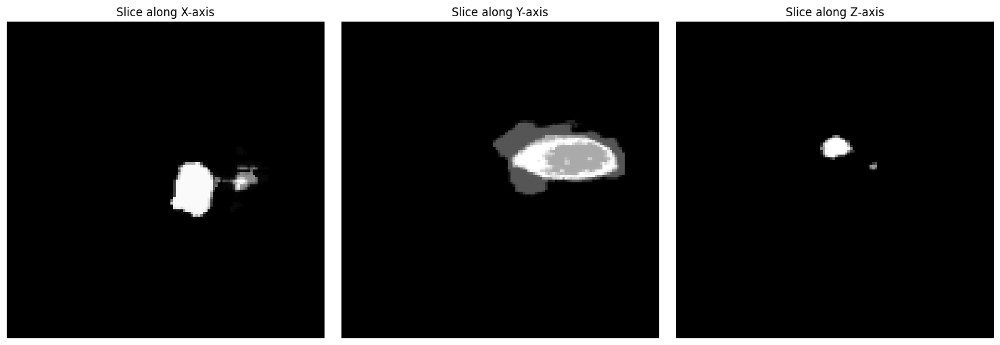

In [15]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming y_data is your dataset with the shape (80, 128, 128, 128)
first_image = y_data[10]  # This selects the first 3D volume

# To visualize slices along the X, Y, and Z axes, choose the middle index for each.
slice_x = first_image[first_image.shape[0] // 2, :, :]
slice_y = first_image[:, first_image.shape[1] // 2, :]
slice_z = first_image[:, :, first_image.shape[2] // 2]

# Now, visualize these slices.
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].imshow(slice_x, cmap='gray')
axes[0].set_title('Slice along X-axis')
axes[0].axis('off')  # Hide the axis for a cleaner look

axes[1].imshow(slice_y, cmap='gray')
axes[1].set_title('Slice along Y-axis')
axes[1].axis('off')

axes[2].imshow(slice_z, cmap='gray')
axes[2].set_title('Slice along Z-axis')
axes[2].axis('off')

plt.tight_layout()
plt.show()


In [16]:
train_size = 160
test_size = 40

# Split into train and test sets
x_train = X_data[:train_size]
y_train = y_data[:train_size]

x_test = X_data[train_size:train_size + test_size]
y_test = y_data[train_size:train_size + test_size]

# Shapes of the train and test sets
print("x_train shape:", x_train.shape)
print("y_train shape:", y_train.shape)
print("x_test shape:", x_test.shape)
print("y_test shape:", y_test.shape)

x_train shape: (160, 128, 128, 128)
y_train shape: (160, 128, 128, 128)
x_test shape: (40, 128, 128, 128)
y_test shape: (40, 128, 128, 128)


In [17]:
from tensorflow.keras import mixed_precision
mixed_precision.set_global_policy('mixed_float16')

2024-03-27 20:42:36.349994: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-27 20:42:36.350101: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-27 20:42:36.640431: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [18]:
import tensorflow as tf

def list_available_gpus():
    gpus = tf.config.list_physical_devices('GPU')
    if gpus:
        print("Available GPUs:")
        for gpu in gpus:
            print(gpu)
    else:
        print("No GPUs available.")

list_available_gpus()


Available GPUs:
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')


# `Model Traning`

# Unet Model

In [19]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv3D, MaxPooling3D, UpSampling3D, concatenate, BatchNormalization, Dropout

def unet_3d_model(input_shape=(128, 128, 128, 1)):
    # Input layer
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling3D(pool_size=(2, 2, 2))(conv1)

    conv2 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling3D(pool_size=(2, 2, 2))(conv2)

    conv3 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling3D(pool_size=(2, 2, 2))(conv3)

    # Bottom layer
    conv4 = Conv3D(256, (3, 3, 3), activation='relu', padding='same')(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv3D(256, (3, 3, 3), activation='relu', padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    conv4 = Dropout(0.5)(conv4)

    # Decoder
    up5 = concatenate([UpSampling3D(size=(2, 2, 2))(conv4), conv3], axis=-1)
    conv5 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(up5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Dropout(0.5)(conv5)

    up6 = concatenate([UpSampling3D(size=(2, 2, 2))(conv5), conv2], axis=-1)
    conv6 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(up6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(conv6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Dropout(0.5)(conv6)
    
    up7 = concatenate([UpSampling3D(size=(2, 2, 2))(conv6), conv1], axis=-1)
    conv7 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(up7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(conv7)
    conv7 = BatchNormalization()(conv7)

    # Output layer
    output = Conv3D(1, (1, 1, 1), dtype="float32", activation='sigmoid')(conv7)
    
    # Model
    model = Model(inputs=inputs, outputs=output)
    return model

# Create the 3D U-Net model
model = unet_3d_model(input_shape=(128, 128, 128, 1))  # Adjust input_shape to match your data
model.summary()


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 128, 1)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_15 (Conv3D)  │ (None, 128, 128,  │        896 │ input_layer_1[0]… │
│                     │ 128, 32)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        128 │ conv3d_15[0][0]   │
│ (BatchNormalizatio… │ 128, 32)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_16 (Conv3D)  │ (None, 128, 128,  │     27,680 │ batch_normalizat… │
│                     │ 128, 32)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        128 │ conv3d_16[0][0]   │
│ (BatchNormalizatio… │ 128, 32)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d_3     │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (MaxPooling3D)      │ 64, 32)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_17 (Conv3D)  │ (None, 64, 64,    │     55,360 │ max_pooling3d_3[… │
│                     │ 64, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv3d_17[0][0]   │
│ (BatchNormalizatio… │ 64, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_18 (Conv3D)  │ (None, 64, 64,    │    110,656 │ batch_normalizat… │
│                     │ 64, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv3d_18[0][0]   │
│ (BatchNormalizatio… │ 64, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d_4     │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (MaxPooling3D)      │ 32, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_19 (Conv3D)  │ (None, 32, 32,    │    221,312 │ max_pooling3d_4[… │
│                     │ 32, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv3d_19[0][0]   │
│ (BatchNormalizatio… │ 32, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_20 (Conv3D)  │ (None, 32, 32,    │    442,496 │ batch_normalizat… │
│                     │ 32, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv3d_20[0][0]   │
│ (BatchNormalizatio… │ 32, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d_5     │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (MaxPooling3D)      │ 16, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_21 (Conv3D)  │ (None, 16, 16,    │    884,992 │ max_pooling3d_5[

 Total params: 5,841,665 (22.28 MB)

 Trainable params: 5,838,849 (22.27 MB)

 Non-trainable params: 2,816 (11.00 KB)

In [20]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
# Define the Dice coefficient function
def dice_coefficient(y_true, y_pred):
    smooth = 1e-5
    # Squeeze the prediction to remove the extra dimension if present
    y_pred = tf.squeeze(y_pred, axis=-1)
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred)
    dice = (2. * intersection + smooth) / (union + smooth)
    return dice
model.compile(optimizer=Adam(learning_rate=1e-2), loss='binary_crossentropy', metrics=[dice_coefficient])

# Fit the model to the training data
history = model.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=60, batch_size=2)

Epoch 1/60


2024-03-25 18:12:56.553467: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f16[2,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[2,32,128,128,128]{4,3,2,1,0}, f16[32,32,3,3,3]{4,3,2,1,0}, f16[32]{0}), window={size=3x3x3 pad=1_1x1_1x1_1}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-25 18:12:58.003099: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 2.449733633s
Trying algorithm eng0{} for conv (f16[2,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[2,32,128,128,128]{4,3,2,1,0}, f16[32,32,3,3,3]{4,3,2,1,0}, f16[32]{0}), window={size=3x3x3 pad=1_1x1_1x1_1}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale"

80/80 ━━━━━━━━━━━━━━━━━━━━ 390s 775ms/step - dice_coefficient: 0.2091 - loss: 0.3270 - val_dice_coefficient: nan - val_loss: nan
Epoch 2/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 57s 708ms/step - dice_coefficient: 0.7143 - loss: -0.0216 - val_dice_coefficient: 0.1556 - val_loss: 2.1624
Epoch 3/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 56s 706ms/step - dice_coefficient: 0.7944 - loss: -0.0313 - val_dice_coefficient: 0.0302 - val_loss: 0.4837
Epoch 4/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 56s 706ms/step - dice_coefficient: 0.8379 - loss: -0.0390 - val_dice_coefficient: 0.2852 - val_loss: 0.9336
Epoch 5/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 56s 704ms/step - dice_coefficient: 0.8340 - loss: -0.0341 - val_dice_coefficient: 0.3011 - val_loss: 0.9886
Epoch 6/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 56s 705ms/step - dice_coefficient: 0.8668 - loss: -0.0474 - val_dice_coefficient: 0.4019 - val_loss: 0.4354
Epoch 7/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 56s 705ms/step - dice_coefficient: 0.8872 - loss: -0.0498 - val_dice_coefficient: 0.5885 - val_loss: 0.

In [ ]:

73/80 ━━━━━━━━━━━━━━━━━━━━ 4s 646ms/step - dice_coefficient: 1.0590 - loss: -0.0874
add Codeadd Markdown

In [26]:
# Plot the validation and training data separately
def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  """ 
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['dice_coefficient']
  val_accuracy = history.history['val_dice_coefficient']

  epochs = range(len(history.history['loss']))
  # Plot loss
  plt.plot(epochs, loss, label='training_loss')
  plt.plot(epochs, val_loss, label='val_loss')
  plt.title('Loss')
  plt.xlabel('Epochs')
  plt.legend()
    
  # Plot accuracy
  plt.figure()
  plt.plot(epochs, accuracy, label='training_accuracy')
  plt.plot(epochs, val_accuracy, label='val_dice_coefficient')
  plt.title('Accuracy')
  plt.xlabel('Epochs')
  plt.legend();

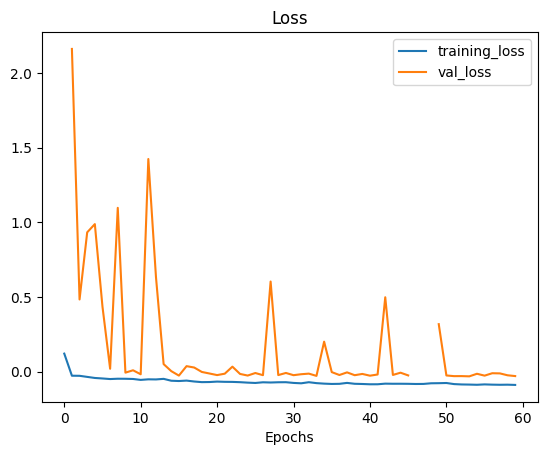

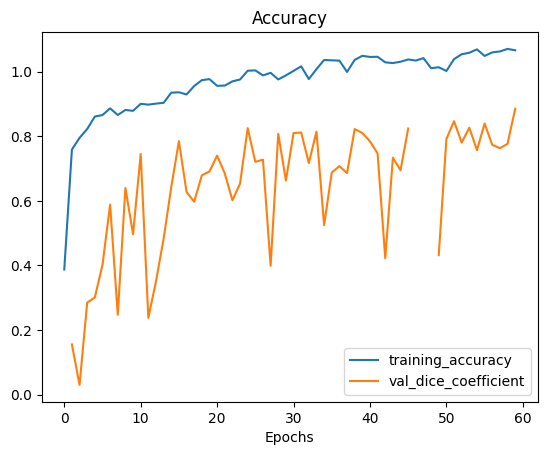

In [22]:
plot_loss_curves(history)

# Vnet Model

In [23]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv3D, MaxPooling3D, UpSampling3D, concatenate, BatchNormalization, Dropout

def vnet_3d_model(input_shape=(128, 128, 128, 1)):
    # Input layer
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv3D(16, (5, 5, 5), activation='relu', padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv2 = Conv3D(32, (5, 5, 5), activation='relu', padding='same')(conv1)
    conv2 = BatchNormalization()(conv2)
    pool1 = MaxPooling3D(pool_size=(2, 2, 2))(conv2)

    conv3 = Conv3D(64, (5, 5, 5), activation='relu', padding='same')(pool1)
    conv3 = BatchNormalization()(conv3)
    conv4 = Conv3D(128, (5, 5, 5), activation='relu', padding='same')(conv3)
    conv4 = BatchNormalization()(conv4)
    pool2 = MaxPooling3D(pool_size=(2, 2, 2))(conv4)

    conv5 = Conv3D(256, (5, 5, 5), activation='relu', padding='same')(pool2)
    conv5 = BatchNormalization()(conv5)
    conv6 = Conv3D(512, (5, 5, 5), activation='relu', padding='same')(conv5)
    conv6 = BatchNormalization()(conv6)

    # Decoder
    up7 = concatenate([UpSampling3D(size=(2, 2, 2))(conv6), conv4], axis=-1)
    conv7 = Conv3D(128, (5, 5, 5), activation='relu', padding='same')(up7)
    conv7 = BatchNormalization()(conv7)
    conv8 = Conv3D(64, (5, 5, 5), activation='relu', padding='same')(conv7)
    conv8 = BatchNormalization()(conv8)

    up9 = concatenate([UpSampling3D(size=(2, 2, 2))(conv8), conv2], axis=-1)
    conv9 = Conv3D(32, (5, 5, 5), activation='relu', padding='same')(up9)
    conv9 = BatchNormalization()(conv9)
    conv10 = Conv3D(16, (5, 5, 5), activation='relu', padding='same')(conv9)
    conv10 = BatchNormalization()(conv10)

    # Output layer
    output = Conv3D(1, (1, 1, 1), dtype="float32", activation='sigmoid')(conv10)

    # Model
    model = Model(inputs=inputs, outputs=output)
    return model

# Create the VNet model
model_Vnet = vnet_3d_model(input_shape=(128, 128, 128, 1))  # Adjust input_shape to match your data
model_Vnet.summary()


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 128, 1)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_30 (Conv3D)  │ (None, 128, 128,  │      2,016 │ input_layer_2[0]… │
│                     │ 128, 16)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │         64 │ conv3d_30[0][0]   │
│ (BatchNormalizatio… │ 128, 16)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_31 (Conv3D)  │ (None, 128, 128,  │     64,032 │ batch_normalizat… │
│                     │ 128, 32)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        128 │ conv3d_31[0][0]   │
│ (BatchNormalizatio… │ 128, 32)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d_6     │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (MaxPooling3D)      │ 64, 32)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_32 (Conv3D)  │ (None, 64, 64,    │    256,064 │ max_pooling3d_6[… │
│                     │ 64, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv3d_32[0][0]   │
│ (BatchNormalizatio… │ 64, 64)           │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_33 (Conv3D)  │ (None, 64, 64,    │  1,024,128 │ batch_normalizat… │
│                     │ 64, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv3d_33[0][0]   │
│ (BatchNormalizatio… │ 64, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling3d_7     │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (MaxPooling3D)      │ 32, 128)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_34 (Conv3D)  │ (None, 32, 32,    │  4,096,256 │ max_pooling3d_7[… │
│                     │ 32, 256)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv3d_34[0][0]   │
│ (BatchNormalizatio… │ 32, 256)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv3d_35 (Conv3D)  │ (None, 32, 32,    │ 16,384,512 │ batch_normalizat… │
│                     │ 32, 512)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      2,048 │ conv3d_35[0][0]   │
│ (BatchNormalizatio… │ 32, 512)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling3d_6     │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (UpSampling3D)      │ 64, 512)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_6       │ (None, 64, 64,    │          0 │ up_sampling3d_6[

 Total params: 33,544,257 (127.96 MB)

 Trainable params: 33,541,761 (127.95 MB)

 Non-trainable params: 2,496 (9.75 KB)

In [24]:

model_Vnet.compile(optimizer=Adam(learning_rate=1e-3), loss='binary_crossentropy', metrics=[dice_coefficient])

# Fit the model to the training data
history = model_Vnet.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=60, batch_size=2)

Epoch 1/60


2024-03-25 19:21:03.936969: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng22{k2=9,k12=-1,k13=1,k14=0,k15=0,k17=8,k18=1,k23=0} for conv (f16[2,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[2,16,128,128,128]{4,3,2,1,0}, f16[32,16,5,5,5]{4,3,2,1,0}, f16[32]{0}), window={size=5x5x5 pad=2_2x2_2x2_2}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-25 19:21:05.432440: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 2.495596957s
Trying algorithm eng22{k2=9,k12=-1,k13=1,k14=0,k15=0,k17=8,k18=1,k23=0} for conv (f16[2,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[2,16,128,128,128]{4,3,2,1,0}, f16[32,16,5,5,5]{4,3,2,1,0}, f16[32]{0}), window={size=5x5x5 pad=2_2x2_2x2_2}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActiva

80/80 ━━━━━━━━━━━━━━━━━━━━ 2310s 4s/step - dice_coefficient: 0.0591 - loss: 0.6651 - val_dice_coefficient: 0.0300 - val_loss: 11.2686
Epoch 2/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 303s 4s/step - dice_coefficient: 0.1064 - loss: 0.3111 - val_dice_coefficient: 0.0279 - val_loss: 15.3071
Epoch 3/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 304s 4s/step - dice_coefficient: 0.1551 - loss: 0.1577 - val_dice_coefficient: 0.0391 - val_loss: 8.4189
Epoch 4/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 302s 4s/step - dice_coefficient: 0.2225 - loss: 0.0705 - val_dice_coefficient: 0.0513 - val_loss: 6.4377
Epoch 5/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 302s 4s/step - dice_coefficient: 0.3036 - loss: 0.0291 - val_dice_coefficient: 0.2901 - val_loss: 0.1622
Epoch 6/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 302s 4s/step - dice_coefficient: 0.3874 - loss: 0.0048 - val_dice_coefficient: 0.3111 - val_loss: 0.1956
Epoch 7/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 302s 4s/step - dice_coefficient: 0.4998 - loss: -0.0179 - val_dice_coefficient: 0.3114 - val_loss: 0.0190
Epoch 

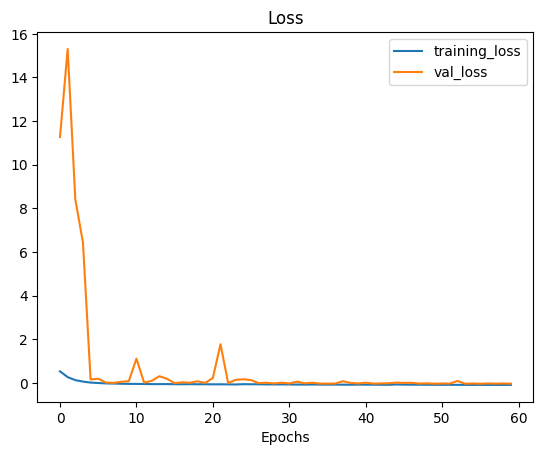

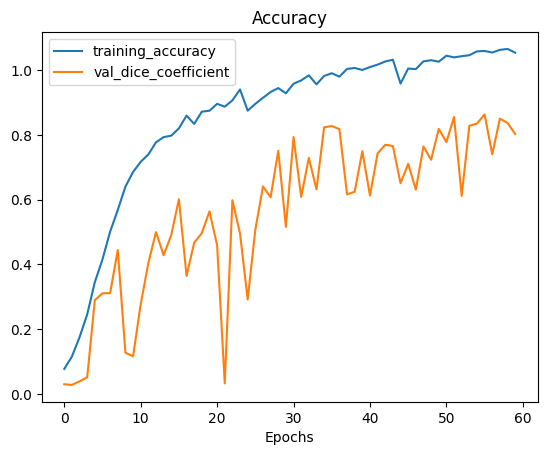

In [25]:
plot_loss_curves(history)

# SegNet Model

In [20]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv3D, MaxPooling3D, UpSampling3D, concatenate, BatchNormalization, Dropout

def segnet_3d_model(input_shape=(128, 128, 128, 1)):
    # Input layer
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling3D(pool_size=(2, 2, 2))(conv1)

    conv2 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling3D(pool_size=(2, 2, 2))(conv2)

    conv3 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling3D(pool_size=(2, 2, 2))(conv3)

    # Bottom layer
    conv4 = Conv3D(256, (3, 3, 3), activation='relu', padding='same')(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv3D(256, (3, 3, 3), activation='relu', padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    conv4 = Dropout(0.5)(conv4)

    # Decoder
    up5 = UpSampling3D(size=(2, 2, 2))(conv4)
    conv5 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(up5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Dropout(0.5)(conv5)

    up6 = UpSampling3D(size=(2, 2, 2))(conv5)
    conv6 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(up6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(conv6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Dropout(0.5)(conv6)
    
    up7 = UpSampling3D(size=(2, 2, 2))(conv6)
    conv7 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(up7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv3D(32, (3, 3, 3), activation='relu', padding='same')(conv7)
    conv7 = BatchNormalization()(conv7)

    # Output layer
    output = Conv3D(1, (1, 1, 1), dtype="float32", activation='sigmoid')(conv7)
    
    # Model
    model = Model(inputs=inputs, outputs=output)
    return model

# Create the 3D SegNet model
model = segnet_3d_model(input_shape=(128, 128, 128, 1))  # Adjust input_shape to match your data
model.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128, 128, 128,  │             0 │
│                                 │ 1)                     │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_2 (Conv3D)               │ (None, 128, 128, 128,  │           896 │
│                                 │ 32)                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 128, 128, 128,  │           128 │
│ (BatchNormalization)            │ 32)                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_3 (Conv3D)               │ (None, 128, 128, 128,  │        27,680 │
│                                 │ 32)                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 128, 128, 128,  │           128 │
│ (BatchNormalization)            │ 32)                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling3d_1 (MaxPooling3D)  │ (None, 64, 64, 64, 32) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_4 (Conv3D)               │ (None, 64, 64, 64, 64) │        55,360 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 64, 64, 64, 64) │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_5 (Conv3D)               │ (None, 64, 64, 64, 64) │       110,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 64, 64, 64, 64) │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling3d_2 (MaxPooling3D)  │ (None, 32, 32, 32, 64) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_6 (Conv3D)               │ (None, 32, 32, 32,     │       221,312 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 32, 32, 32,     │           512 │
│ (BatchNormalization)            │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_7 (Conv3D)               │ (None, 32, 32, 32,     │       442,496 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32, 32, 32,     │           512 │
│ (BatchNormalization)            │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling3d_3 (MaxPooling3D)  │ (None, 16, 16, 16,     │             0 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_8 (Conv3D)               │ (None, 16, 16, 16,     │       884,992 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 16, 16, 16,     │         1,024 │
│ (BatchNormalization)            │ 256)                   │             

 Total params: 5,261,057 (20.07 MB)

 Trainable params: 5,258,241 (20.06 MB)

 Non-trainable params: 2,816 (11.00 KB)

In [23]:
from tensorflow.keras.optimizers import Adam 


def dice_coefficient(y_true, y_pred):
    smooth = 1e-5
    # Squeeze the prediction to remove the extra dimension if present
    y_pred = tf.squeeze(y_pred, axis=-1)
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred)
    dice = (2. * intersection + smooth) / (union + smooth)
    return dice
model.compile(optimizer=Adam(learning_rate=1e-2), loss='binary_crossentropy', metrics=[dice_coefficient])

# Fit the model to the training data
history = model.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=60, batch_size=2)


Epoch 1/60


2024-03-27 20:53:17.951184: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f16[2,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[2,32,128,128,128]{4,3,2,1,0}, f16[32,32,3,3,3]{4,3,2,1,0}, f16[32]{0}), window={size=3x3x3 pad=1_1x1_1x1_1}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-27 20:53:19.339308: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 2.388293814s
Trying algorithm eng0{} for conv (f16[2,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[2,32,128,128,128]{4,3,2,1,0}, f16[32,32,3,3,3]{4,3,2,1,0}, f16[32]{0}), window={size=3x3x3 pad=1_1x1_1x1_1}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale"

80/80 ━━━━━━━━━━━━━━━━━━━━ 304s 608ms/step - dice_coefficient: 0.1466 - loss: 0.5026 - val_dice_coefficient: nan - val_loss: nan
Epoch 2/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 43s 542ms/step - dice_coefficient: 0.6120 - loss: 0.0012 - val_dice_coefficient: 0.0836 - val_loss: 4.8044
Epoch 3/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 44s 548ms/step - dice_coefficient: 0.7134 - loss: -0.0104 - val_dice_coefficient: 0.3111 - val_loss: 0.6077
Epoch 4/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 43s 542ms/step - dice_coefficient: 0.7685 - loss: -0.0232 - val_dice_coefficient: 0.3567 - val_loss: 0.2982
Epoch 5/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 44s 544ms/step - dice_coefficient: 0.7490 - loss: -0.0177 - val_dice_coefficient: 0.3536 - val_loss: 0.4749
Epoch 6/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 44s 544ms/step - dice_coefficient: 0.7677 - loss: -0.0261 - val_dice_coefficient: 0.4853 - val_loss: 0.0585
Epoch 7/60
80/80 ━━━━━━━━━━━━━━━━━━━━ 44s 544ms/step - dice_coefficient: 0.8077 - loss: -0.0299 - val_dice_coefficient: 0.4329 - val_loss: 0.1

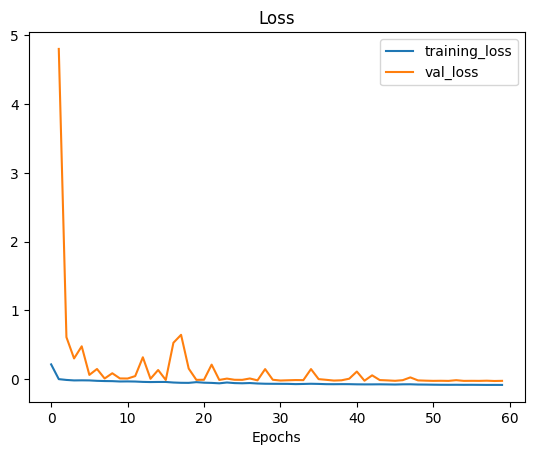

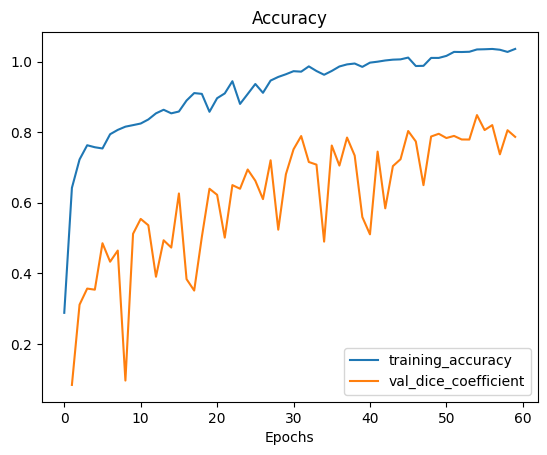

In [27]:
plot_loss_curves(history)

In [28]:
nii_image_path="/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/BRATS_055.nii.gz"
nii_img = nib.load(nii_image_path)

# Get the image data
nii_data = nii_img.get_fdata()

print(nii_data.shape)

(240, 240, 155, 4)


In [29]:
data=nii_data[...,0]
data.shape

(240, 240, 155)

In [30]:
new_shape = (128, 128, 128)
resized_data = resize(data, new_shape, anti_aliasing=True)
# Ensure the resized image data has a single channel
resized_data = np.expand_dims(resized_data, axis=-1)
# Perform prediction
prediction = model.predict(np.expand_dims(resized_data, axis=0))

2024-03-27 21:43:53.827543: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f16[1,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[1,32,128,128,128]{4,3,2,1,0}, f16[32,32,3,3,3]{4,3,2,1,0}, f16[32]{0}), window={size=3x3x3 pad=1_1x1_1x1_1}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-27 21:43:54.076878: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.24944983s
Trying algorithm eng0{} for conv (f16[1,32,128,128,128]{4,3,2,1,0}, u8[0]{0}) custom-call(f16[1,32,128,128,128]{4,3,2,1,0}, f16[32,32,3,3,3]{4,3,2,1,0}, f16[32]{0}), window={size=3x3x3 pad=1_1x1_1x1_1}, dim_labels=bf012_oi012->bf012, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":

1/1 ━━━━━━━━━━━━━━━━━━━━ 36s 36s/step


In [31]:
prediction.shape

(1, 128, 128, 128, 1)

In [32]:
predicted_data = prediction[0]
predicted_data.shape

(128, 128, 128, 1)

In [35]:
from tensorflow.keras.models import load_model
from skimage.transform import resize
import matplotlib.pyplot as plt

def predicted_segmentation(nii_image_path):
    # Load the NIfTI image
    nii_img = nib.load(nii_image_path)

    # Get the image data
    nii_data = nii_img.get_fdata()

    # Resize the image data to match the required input shape (128, 128, 128)
    new_shape = (128, 128, 128)
    resized_data = resize(nii_data, new_shape, anti_aliasing=True)

    # Ensure the resized image data has a single channel
    resized_data = np.expand_dims(resized_data, axis=-1)
    # Perform prediction
    prediction = model.predict(np.expand_dims(resized_data, axis=0))

    # Extract the volume from the batch dimension
    predicted_data = prediction[0]

    # Plot a slice of the predicted volume (e.g., middle slice along each axis)
    slice_x = predicted_data.shape[0] // 2
    slice_y = predicted_data.shape[1] // 2
    slice_z = predicted_data.shape[2] // 2

    plt.figure(figsize=(15, 5))

    # Plot slices along the X-axis
    plt.subplot(1, 3, 1)
    plt.imshow(predicted_data[slice_x, :, :, 0], cmap='gray')
    plt.title('Slice along X-axis')

    # Plot slices along the Y-axis
    plt.subplot(1, 3, 2)
    plt.imshow(predicted_data[:, slice_y, :, 0], cmap='gray')
    plt.title('Slice along Y-axis')
    # Plot slices along the Z-axis
    plt.subplot(1, 3, 3)
    plt.imshow(predicted_data[:, :, slice_z, 0], cmap='gray')
    plt.title('Slice along Z-axis')

    plt.show()

In [36]:
def actual_segmentation(label_path):
    # Load the label image
    label_img = nib.load(label_path)
    
    # Get the image data
    actual_label = label_img.get_fdata()

    # Plot a slice of the image (e.g., middle slice along each axis)
    slice_x = actual_label.shape[0] // 2
    slice_y = actual_label.shape[1] // 2
    slice_z = actual_label.shape[2] // 2

    plt.figure(figsize=(10, 10))

    plt.subplot(1, 3, 1)
    plt.imshow(actual_label[slice_x, :, :], cmap='gray')
    plt.title('Slice along X-axis')

    plt.subplot(1, 3, 2)
    plt.imshow(actual_label[:, slice_y, :], cmap='gray')
    plt.title('Slice along Y-axis')
    plt.subplot(1, 3, 3)
    plt.imshow(actual_label[:, :, slice_z], cmap='gray')
    plt.title('Slice along Z-axis')

    plt.show()

In [45]:
label_path = "/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_055.nii.gz"
actual_segmentation(label_path)

<IPython.core.display.Javascript object>

In [44]:
predicted_segmentation("/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_055.nii.gz")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


<IPython.core.display.Javascript object>

In [39]:
!pip install celluloid

In [40]:
!pip install IPython

In [41]:
%matplotlib notebook
from pathlib import Path
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np
from celluloid import Camera
from IPython.display import HTML

In [42]:
# Define the paths to the image and label files
image_path = Path("/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/BRATS_055.nii.gz")
label_path = Path("/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_055.nii.gz")

# Load the image and label data
image_data = nib.load(image_path).get_fdata()
label_data = nib.load(label_path).get_fdata().astype(int)  # Class labels should not be handled as float64

# Create the figure and camera object
fig = plt.figure()
camera = Camera(fig)
# Iterate over slices in the z-axis
for i in range(image_data.shape[2]):
    # Display the CT scan slice
    plt.imshow(image_data[:,:,i,1], cmap="bone")
    # Overlay the label mask with transparency
    mask = np.ma.masked_where(label_data[:,:,i] == 0, label_data[:,:,i])
    plt.imshow(mask, alpha=0.5)
    camera.snap()  # Store the current slice

# Animate the slices
plt.tight_layout()
animation = camera.animate()

<IPython.core.display.Javascript object>

In [43]:
HTML(animation.to_html5_video())

# Experiments

In [50]:
# Define the paths to the image and label files
image_path = Path("/kaggle/working/extracted_data/Task01_BrainTumour/imagesTr/BRATS_055.nii.gz")
label_path = Path("/kaggle/working/extracted_data/Task01_BrainTumour/labelsTr/BRATS_055.nii.gz")

# Load the image and label data
image_data = nib.load(image_path).get_fdata()
label_data = nib.load(label_path).get_fdata().astype(int)  # Class labels should not be handled as float64

# Create the figure and camera object
fig = plt.figure()
camera = Camera(fig)

# Iterate over slices in the z-axis
for i in range(image_data.shape[2]):
    # Display the CT scan slice
    plt.imshow(image_data[:,:,i,1], cmap="bone")
    # Overlay the label mask with transparency
    mask = np.ma.masked_where(label_data[:,:,i] == 0, label_data[:,:,i])
    plt.imshow(mask, alpha=0.5)
    camera.snap()  # Store the current slice

plt.tight_layout()
animation = camera.animate()

# Display the animation as HTML5 video
HTML(animation.to_jshtml())


<IPython.core.display.Javascript object>